# New York City traffic analysis over the past ten years

![brooklyn_shooting](brooklyn_shooting.webp)

![Driving](drive.jpeg)

## Project Outline 
**Data Source:** 
- Motor Vehicle Collisions - Crashes dataset from NYC Open Data  

**Today’s Presentation:** 
- Part I. Traffic Condition Overview
- Part II. Factors Analysis
- Part III. Risk Prediction
- Part IV. Policy Suggestions & Limitations


## Import dataset

In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import folium
import json
from functools import reduce
import warnings
warnings.filterwarnings("ignore")

In [2]:
df = pd.read_csv('collision_data_clean.csv', index_col=0)
df.head()

,CRASH DATE,CRASH TIME,BOROUGH,ZIP CODE,LATITUDE,LONGITUDE,LOCATION,ON STREET NAME,CROSS STREET NAME,OFF STREET NAME,...,VEHICLE TYPE CODE 5,datetime,Number_of_injuries,Number_of_death,Total_injury_death,Year,Month,Day,Hour,Day_of_week
1,04/13/2021,21:35,BROOKLYN,11217,40.68358,-73.97617,"(40.68358, -73.97617)",NaN,NaN,620 ATLANTIC AVENUE,...,NaN,2021-04-13 21:35:00,2.0,0.0,2.0,2021,4,13,21,1
3,04/13/2021,16:00,BROOKLYN,11222,NaN,NaN,NaN,VANDERVORT AVENUE,ANTHONY STREET,NaN,...,NaN,2021-04-13 16:00:00,0.0,0.0,0.0,2021,4,13,16,1
6,04/13/2021,17:30,QUEENS,11106,NaN,NaN,NaN,33 st,31ave,NaN,...,NaN,2021-04-13 17:30:00,0.0,0.0,0.0,2021,4,13,17,1
10,04/11/2021,21:06,BROOKLYN,11226,NaN,NaN,NaN,BEVERLEY ROAD,EAST 21 STREET,NaN,...,NaN,2021-04-11 21:06:00,2.0,0.0,2.0,2021,4,11,21,6
11,04/15/2021,20:00,STATEN ISLAND,10304,NaN,NaN,NaN,GREENFIELD AVENUE,OSGOOD AVENUE,NaN,...,NaN,2021-04-15 20:00:00,0.0,0.0,0.0,2021,4,15,20,3


In [3]:
df.describe()

,ZIP CODE,LATITUDE,LONGITUDE,COLLISION_ID,Number_of_injuries,Number_of_death,Total_injury_death,Year,Month,Day,Hour,Day_of_week
count,1.299317e+06,1.265451e+06,1.265451e+06,1.299317e+06,1.299306e+06,1.299294e+06,1.299291e+06,1.299317e+06,1.299317e+06,1.299317e+06,1.299317e+06,1.299317e+06
mean,1.083712e+04,4.066334e+01,-7.381379e+01,2.825265e+06,5.416422e-01,2.381293e-03,5.440113e-01,2.016278e+03,6.665508e+00,1.562865e+01,1.332258e+01,2.907645e+00
std,5.559938e+02,1.556209e+00,2.822499e+00,1.614795e+06,1.298707e+00,7.279253e-02,1.301911e+00,2.621809e+00,3.435327e+00,8.758107e+00,5.618555e+00,1.946226e+00
min,1.000000e+04,0.000000e+00,-7.425453e+01,2.200000e+01,0.000000e+00,0.000000e+00,0.000000e+00,2.012000e+03,1.000000e+00,1.000000e+00,0.000000e+00,0.000000e+00
25%,1.030600e+04,4.066708e+01,-7.397696e+01,1.003513e+06,0.000000e+00,0.000000e+00,0.000000e+00,2.014000e+03,4.000000e+00,8.000000e+00,1.000000e+01,1.000000e+00
50%,1.120700e+04,4.071940e+01,-7.393032e+01,3.502742e+06,0.000000e+00,0.000000e+00,0.000000e+00,2.016000e+03,7.000000e+00,1.600000e+01,1.400000e+01,3.000000e+00
75%,1.123700e+04,4.076623e+01,-7.387084e+01,4.019112e+06,0.000000e+00,0.000000e+00,0.000000e+00,2.018000e+03,1.000000e+01,2.300000e+01,1.800000e+01,5.000000e+00
max,1.169700e+04,4.112615e+01,0.000000e+00,4.519144e+06,8.600000e+01,1.600000e+01,8.600000e+01,2.022000e+03,1.200000e+01,3.100000e+01,2.300000e+01,6.000000e+00


In [4]:
df.columns

Index(['CRASH DATE', 'CRASH TIME', 'BOROUGH', 'ZIP CODE', 'LATITUDE',
       'LONGITUDE', 'LOCATION', 'ON STREET NAME', 'CROSS STREET NAME',
       'OFF STREET NAME', 'CONTRIBUTING FACTOR VEHICLE 1',
       'CONTRIBUTING FACTOR VEHICLE 2', 'CONTRIBUTING FACTOR VEHICLE 3',
       'CONTRIBUTING FACTOR VEHICLE 4', 'CONTRIBUTING FACTOR VEHICLE 5',
       'COLLISION_ID', 'VEHICLE TYPE CODE 1', 'VEHICLE TYPE CODE 2',
       'VEHICLE TYPE CODE 3', 'VEHICLE TYPE CODE 4', 'VEHICLE TYPE CODE 5',
       'datetime', 'Number_of_injuries', 'Number_of_death',
       'Total_injury_death', 'Year', 'Month', 'Day', 'Hour', 'Day_of_week'],
      dtype='object')

In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1299317 entries, 1 to 1882292
Data columns (total 30 columns):
 #   Column                         Non-Null Count    Dtype  
---  ------                         --------------    -----  
 0   CRASH DATE                     1299317 non-null  object 
 1   CRASH TIME                     1299317 non-null  object 
 2   BOROUGH                        1299317 non-null  object 
 3   ZIP CODE                       1299317 non-null  int64  
 4   LATITUDE                       1265451 non-null  float64
 5   LONGITUDE                      1265451 non-null  float64
 6   LOCATION                       1265451 non-null  object 
 7   ON STREET NAME                 1036881 non-null  object 
 8   CROSS STREET NAME              1036345 non-null  object 
 9   OFF STREET NAME                261876 non-null   object 
 10  CONTRIBUTING FACTOR VEHICLE 1  1295048 non-null  object 
 11  CONTRIBUTING FACTOR VEHICLE 2  1097335 non-null  object 
 12  CONTRIBUTING F

## 1. Traffic Condition Overview

### Map: Total Number of collisions over past 10 year by zip code

In [6]:
sizes = df.groupby("ZIP CODE").size()
sizes = sizes.reset_index().rename(columns={"ZIP CODE":"zipcodes",0:"sizes"})
sizes['sizes'] = sizes['sizes'].astype('int')
sizes['zipcodes'] = sizes['zipcodes'].astype('str')

In [7]:
f = open("nyc_geojson_by_zip.json",'r')
content = f.read()
import json
geojson_data = json.loads(content)
for feature in geojson_data['features']:
    zipcode = feature['properties']['postalCode']
    try:
        size = str(sizes.set_index('zipcodes').loc[zipcode]['sizes'])
    except:
        size = "?"
    post_office = feature['properties']['PO_NAME']
    display_string = zipcode + "; "  + post_office + "; " +  size 
    feature['properties']['display'] = display_string

In [8]:
m=folium.Map(location = [40.7589,-73.9851],zoom_start=10)
c = folium.Choropleth(geo_data=geojson_data,
                      data=sizes, #the data frame from which the data is drawn
                     columns=['zipcodes','sizes'], #The columns (column 0 is for geographical data, col 1 the statistic)
                      key_on='feature.properties.postalCode', #Will map to column 0 of sizes
                      fill_color='YlOrRd', #the color scheme
                      legend_name="Distribution of Collision", #the name for the legend
                     highlight=True) #When hovering over a zip, it will be highlighted
c.add_to(m)
c.geojson.add_child(
    folium.features.GeoJsonTooltip(['display'],labels=False)
)

#m.save("Total_Number_of_Collision_for_10_year.html")
m

### Heatmap: time change for collisions by location

In [9]:
collision_data = df
collision_data['datetime'] = pd.to_datetime(df['datetime'])
collision_data['yyyymm'] = df['datetime'].dt.strftime('%Y%m') 
collision_data.dropna(subset = ['LATITUDE'],inplace = True)
collision_data.dropna(subset = ['LONGITUDE'],inplace = True)
collision_data.reset_index(drop=True, inplace = True)
collision_data.set_index("yyyymm",inplace=True)

In [10]:
#Create the list of lists
yyyymm_list = list()
months = sorted(collision_data.index.unique())


for yyyymm in months: #cycle through the (sorted) months
    print(yyyymm)
    mini_df = collision_data.loc[yyyymm] #Extract data for that month
    latlon = list([list(x) for x in zip(mini_df.LATITUDE, mini_df.LONGITUDE)]) #Extract latitude and longitude
    yyyymm_list.append(latlon) #append sublist to the list of lists



201207
201208
201209
201210
201211
201212
201301
201302
201303
201304
201305
201306
201307
201308
201309
201310
201311
201312
201401
201402
201403
201404
201405
201406
201407
201408
201409
201410
201411
201412
201501
201502
201503
201504
201505
201506
201507
201508
201509
201510
201511
201512
201601
201602
201603
201604
201605
201606
201607
201608
201609
201610
201611
201612
201701
201702
201703
201704
201705
201706
201707
201708
201709
201710
201711
201712
201801
201802
201803
201804
201805
201806
201807
201808
201809
201810
201811
201812
201901
201902
201903
201904
201905
201906
201907
201908
201909
201910
201911
201912
202001
202002
202003
202004
202005
202006
202007
202008
202009
202010
202011
202012
202101
202102
202103
202104
202105
202106
202107
202108
202109
202110
202111
202112
202201
202202
202203
202204


In [11]:
from folium.plugins import HeatMapWithTime
m=folium.Map(location = [40.7589,-73.9851],zoom_start=10)

hm = HeatMapWithTime(data=yyyymm_list,index=months,radius=3)

hm.add_to(m)
#m.save("heatmap.html")
m

### Collisions share of each borough

Text(0.5, 0.98, 'Borough Share of Crashes')

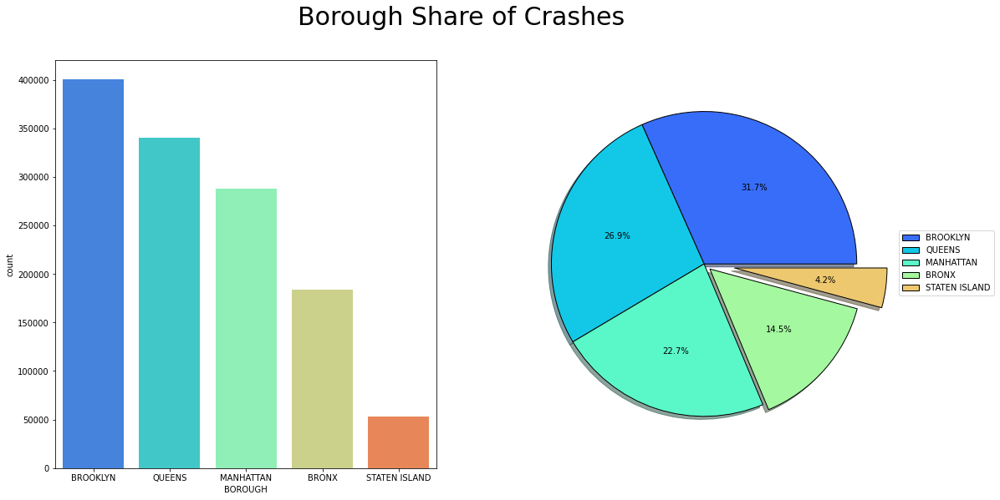

In [12]:
fig, (ax1,ax2) = plt.subplots(1,2,figsize=(18,9))
sns.countplot(x="BOROUGH",data=df,order=["BROOKLYN","QUEENS","MANHATTAN","BRONX","STATEN ISLAND"],
              ax=ax1,palette="rainbow",)

colors = sns.color_palette("rainbow")
explode=[0,0,0,0.05,0.2]
ax2.pie(df["BOROUGH"].value_counts(),autopct="%1.1f%%",
       wedgeprops={"edgecolor":"black"},shadow=True,explode=explode,colors=colors)

plt.legend(bbox_to_anchor=(1,0.6),labels=["BROOKLYN","QUEENS","MANHATTAN","BRONX","STATEN ISLAND"])
fig.suptitle("Borough Share of Crashes",fontsize=30)

### Number of collisions change by time

Text(0, 0.5, 'Number of Collisions by hour')

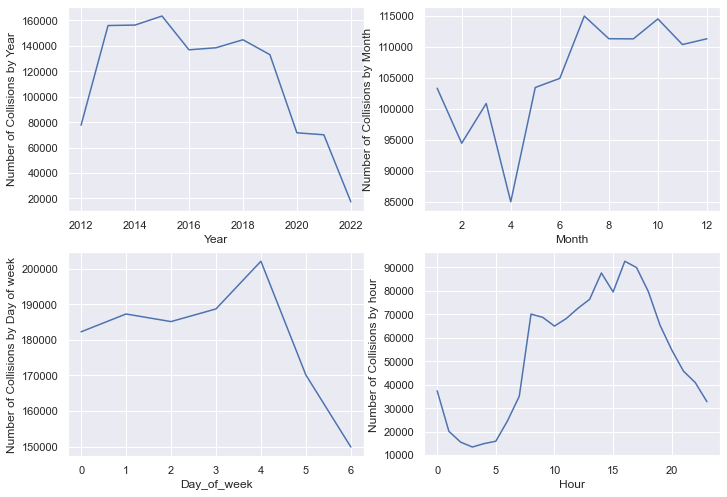

In [13]:
year = df.groupby('Year').size()
month = df.groupby('Month').size()
dayofweek = df.groupby('Day_of_week').size()
hour = df.groupby('Hour').size()

sns.set(rc={'figure.figsize':(11.7,8.27)})

#define plotting region (2 rows, 2 columns)
fig, axes = plt.subplots(2, 2)

#create lineplot in each subplot
plot_year = sns.lineplot(data=year, ax=axes[0,0])
plot_year.set_xlabel("Year")
plot_year.set_ylabel("Number of Collisions by Year")

plot_month = sns.lineplot(data=month, ax=axes[0,1])
plot_month.set_xlabel("Month")
plot_month.set_ylabel("Number of Collisions by Month")

plot_dw = sns.lineplot(data=dayofweek, ax=axes[1,0])
plot_dw.set_xlabel("Day_of_week")
plot_dw.set_ylabel("Number of Collisions by Day of week")

plot_hour = sns.lineplot(data=hour, ax=axes[1,1])
plot_hour.set_xlabel("Hour")
plot_hour.set_ylabel("Number of Collisions by hour")


Text(0, 0.5, 'Number of Collisions by hour')

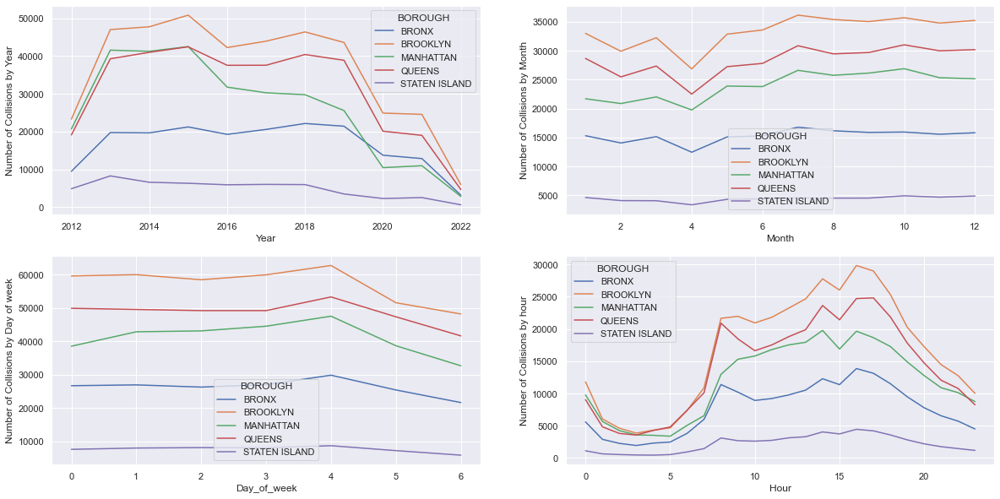

In [14]:
borough_year_line = pd.DataFrame(df.groupby(['Year', 'BOROUGH'])['ZIP CODE'].count())
borough_year_line.reset_index(inplace = True)
borough_year_line.rename(columns = {'ZIP CODE': 'Number_of_collisions'}, inplace = True)

borough_month_line = pd.DataFrame(df.groupby(['Month', 'BOROUGH'])['ZIP CODE'].count())
borough_month_line.reset_index(inplace = True)
borough_month_line.rename(columns = {'ZIP CODE': 'Number_of_collisions'}, inplace = True)

borough_dow_line = pd.DataFrame(df.groupby(['Day_of_week', 'BOROUGH'])['ZIP CODE'].count())
borough_dow_line.reset_index(inplace = True)
borough_dow_line.rename(columns = {'ZIP CODE': 'Number_of_collisions'}, inplace = True)

borough_hour_line = pd.DataFrame(df.groupby(['Hour', 'BOROUGH'])['ZIP CODE'].count())
borough_hour_line.reset_index(inplace = True)
borough_hour_line.rename(columns = {'ZIP CODE': 'Number_of_collisions'}, inplace = True)

sns.set(rc={'figure.figsize':(20,10)})

#define plotting region (2 rows, 2 columns)
fig, axes = plt.subplots(2, 2)

#create lineplot in each subplot
plot_year = sns.lineplot(x = 'Year', y = 'Number_of_collisions', hue = 'BOROUGH', data = borough_year_line, ax=axes[0,0])
plot_year.set_xlabel("Year")
plot_year.set_ylabel("Number of Collisions by Year")

plot_month = sns.lineplot(x = 'Month', y = 'Number_of_collisions', hue = 'BOROUGH', data = borough_month_line, ax=axes[0,1])
plot_month.set_xlabel("Month")
plot_month.set_ylabel("Number of Collisions by Month")

plot_dw = sns.lineplot(x = 'Day_of_week', y = 'Number_of_collisions', hue = 'BOROUGH', data = borough_dow_line, ax=axes[1,0])
plot_dw.set_xlabel("Day_of_week")
plot_dw.set_ylabel("Number of Collisions by Day of week")

plot_hour = sns.lineplot(x = 'Hour', y = 'Number_of_collisions', hue = 'BOROUGH', data = borough_hour_line, ax=axes[1,1])
plot_hour.set_xlabel("Hour")
plot_hour.set_ylabel("Number of Collisions by hour")




### Collisions yearly change by borough

In [15]:
year_collision = pd.DataFrame(df.groupby(['BOROUGH','Year'])['BOROUGH'].count())
year_collision_new = year_collision.unstack().T
year_collision_new.reset_index(inplace=True)
year_collision_new.drop('level_0', axis = 1, inplace=True)
year_collision_new.set_index('Year', inplace = True)
final_year_collision = year_collision_new.T
final_year_collision.columns = final_year_collision.columns.astype('str')
final_year_collision['2023'] = final_year_collision['2012']


In [16]:
from bokeh.io import output_notebook, show
from bokeh.plotting import figure
from bokeh.models import ColumnDataSource

output_notebook()

Loading BokehJS ...

In [17]:
from bokeh.layouts import column, row
from bokeh.models import CustomJS, Slider
from bokeh.plotting import ColumnDataSource, figure, show, output_notebook

source = ColumnDataSource(final_year_collision)

tooltips = [
    ('Total number of collision', '@2023')
]

p = figure(x_range=source.data['BOROUGH'], plot_height=400, 
           x_axis_label = "Borough",
           y_axis_label = "Number of collision",
           title="Chart",
           tooltips=tooltips)

p.vbar(x = 'BOROUGH', 
       top = '2023', 
       source = source,
       width = 0.5, 
       color = "cyan")

p.xgrid.grid_line_color = None
p.y_range.start = 0    

#FILL THIS IN (https://docs.bokeh.org/en/latest/docs/gallery/slider.html)
slider = Slider(start = 2012, end = 2022, value = 0, step = 1, title="Year")

jscallback = CustomJS(args = {'source':source, 'slider':slider}, code="""
        // widget. this.item is the selected value
        // We can print it on the JavaScript console
        // Chrome windows/linux: Ctrl - Shift - J
        // Chrom mac: Cmd - Option - J
        // Safari: Option - Cmd - C
        
        console.log(' changed selected option', slider.value);

        //data is the variable containing all the data
        var data = source.data;
        var col = this.value
        console.log(' changed selected option', data[col]);
        
        // allocate the selected column to the field for the y values
        data['2023'] = data[col];

        // register the change 
        source.change.emit();
""")

slider.js_on_change("value", jscallback)

layout = row(p,slider)
show(layout)

### Collisions monthly change by borough

In [18]:
month_collision = pd.DataFrame(df.groupby(['BOROUGH','Month'])['BOROUGH'].count())
month_collision_new = month_collision.unstack().T
month_collision_new.reset_index(inplace=True)
month_collision_new.drop('level_0', axis = 1, inplace=True)
month_collision_new.set_index('Month', inplace = True)
final_month_collision = month_collision_new.T
final_month_collision.columns = final_month_collision.columns.astype('str')
month_collision_new = month_collision.unstack().T
final_month_collision['13'] = final_month_collision['1']


In [19]:
from bokeh.layouts import column, row
from bokeh.models import CustomJS, Slider
from bokeh.plotting import ColumnDataSource, figure, show, output_notebook

source = ColumnDataSource(final_month_collision)

tooltips = [
    ('Total number of collision', '@13')
]

p = figure(x_range=source.data['BOROUGH'], plot_height=400, 
           x_axis_label = "Borough",
           y_axis_label = "Number of collision",
           title="Chart",
           tooltips=tooltips)

p.vbar(x = 'BOROUGH', 
       top = '13', 
       source = source,
       width = 0.5, 
       color = "cyan")

p.xgrid.grid_line_color = None
p.y_range.start = 0    

#FILL THIS IN (https://docs.bokeh.org/en/latest/docs/gallery/slider.html)
slider = Slider(start = 1, end = 12, value = 0, step = 1, title="Month")

jscallback = CustomJS(args = {'source':source, 'slider':slider}, code="""
        // widget. this.item is the selected value
        // We can print it on the JavaScript console
        // Chrome windows/linux: Ctrl - Shift - J
        // Chrom mac: Cmd - Option - J
        // Safari: Option - Cmd - C
        
        console.log(' changed selected option', slider.value);

        //data is the variable containing all the data
        var data = source.data;
        var col = this.value
        console.log(' changed selected option', data[col]);
        
        // allocate the selected column to the field for the y values
        data['13'] = data[col];

        // register the change 
        source.change.emit();
""")

slider.js_on_change("value", jscallback)

layout = row(p,slider)
show(layout)

### Collisions weekly change by borough

In [20]:
day_of_week_collision = pd.DataFrame(df.groupby(['BOROUGH','Day_of_week'])['BOROUGH'].count())
day_of_week_collision_new = day_of_week_collision.unstack().T
day_of_week_collision_new.reset_index(inplace=True)
day_of_week_collision_new.drop('level_0', axis = 1, inplace=True)
day_of_week_collision_new.drop('Day_of_week', axis = 1, inplace=True)
final_day_of_week_collision = day_of_week_collision_new.T
final_day_of_week_collision.columns = final_day_of_week_collision.columns.astype('str')
final_day_of_week_collision['7'] = final_day_of_week_collision['0']

In [21]:
from bokeh.layouts import column, row
from bokeh.models import CustomJS, Slider
from bokeh.plotting import ColumnDataSource, figure, show, output_notebook

source = ColumnDataSource(final_day_of_week_collision)

tooltips = [
    ('Total number of collision', '@7')
]

p = figure(x_range=source.data['BOROUGH'], plot_height=400, 
           x_axis_label = "Borough",
           y_axis_label = "Number of collision",
           title="Chart",
           tooltips=tooltips)

p.vbar(x = 'BOROUGH', 
       top = '7', 
       source = source,
       width = 0.5, 
       color = "cyan")

p.xgrid.grid_line_color = None
p.y_range.start = 0    

#FILL THIS IN (https://docs.bokeh.org/en/latest/docs/gallery/slider.html)
slider = Slider(start = 0, end = 6, value = 0, step = 1, title="day of week")

jscallback = CustomJS(args = {'source':source, 'slider':slider}, code="""
        // widget. this.item is the selected value
        // We can print it on the JavaScript console
        // Chrome windows/linux: Ctrl - Shift - J
        // Chrom mac: Cmd - Option - J
        // Safari: Option - Cmd - C
        
        console.log(' changed selected option', slider.value);

        //data is the variable containing all the data
        var data = source.data;
        var col = this.value
        console.log(' changed selected option', data[col]);
        
        // allocate the selected column to the field for the y values
        data['7'] = data[col];

        // register the change 
        source.change.emit();
""")

slider.js_on_change("value", jscallback)

layout = row(p,slider)
show(layout)

### Collisions hourly change by borough

In [22]:
hour_collision = pd.DataFrame(df.groupby(['BOROUGH','Hour'])['BOROUGH'].count())
hour_collision_new = hour_collision.unstack().T
hour_collision_new.reset_index(inplace=True)
hour_collision_new.drop('level_0', axis = 1, inplace=True)
hour_collision_new.drop('Hour', axis = 1, inplace=True)
final_hour_collision_new = hour_collision_new.T
final_hour_collision_new.columns = final_hour_collision_new.columns.astype('str')
final_hour_collision_new['24'] = final_hour_collision_new['0']


In [23]:
from bokeh.layouts import column, row
from bokeh.models import CustomJS, Slider
from bokeh.plotting import ColumnDataSource, figure, show, output_notebook

source = ColumnDataSource(final_hour_collision_new)

tooltips = [
    ('Total number of collision', '@24')
]

p = figure(x_range=source.data['BOROUGH'], plot_height=400, 
           x_axis_label = "Borough",
           y_axis_label = "Number of collision",
           title="Chart",
           tooltips=tooltips)

p.vbar(x = 'BOROUGH', 
       top = '24', 
       source = source,
       width = 0.5, 
       color = "cyan")

p.xgrid.grid_line_color = None
p.y_range.start = 0    

#FILL THIS IN (https://docs.bokeh.org/en/latest/docs/gallery/slider.html)
slider = Slider(start = 0, end = 23, value = 0, step = 1, title="Hour")

jscallback = CustomJS(args = {'source':source, 'slider':slider}, code="""
        // widget. this.item is the selected value
        // We can print it on the JavaScript console
        // Chrome windows/linux: Ctrl - Shift - J
        // Chrom mac: Cmd - Option - J
        // Safari: Option - Cmd - C
        
        console.log(' changed selected option', slider.value);

        //data is the variable containing all the data
        var data = source.data;
        var col = this.value
        console.log(' changed selected option', data[col]);
        
        // allocate the selected column to the field for the y values
        data['24'] = data[col];

        // register the change 
        source.change.emit();
""")

slider.js_on_change("value", jscallback)

layout = row(p,slider)
show(layout)

### Injuries and death share of each borough

In [24]:
borough_injury = pd.DataFrame(df.groupby('BOROUGH').Total_injury_death.sum())
borough_injury.reset_index(inplace = True)


In [25]:
borough_injury

,BOROUGH,Total_injury_death
0,BRONX,111473.0
1,BROOKLYN,247681.0
2,MANHATTAN,110303.0
3,QUEENS,189970.0
4,STATEN ISLAND,28558.0


Text(0.5, 0.98, 'Borough Share of injuries and death')

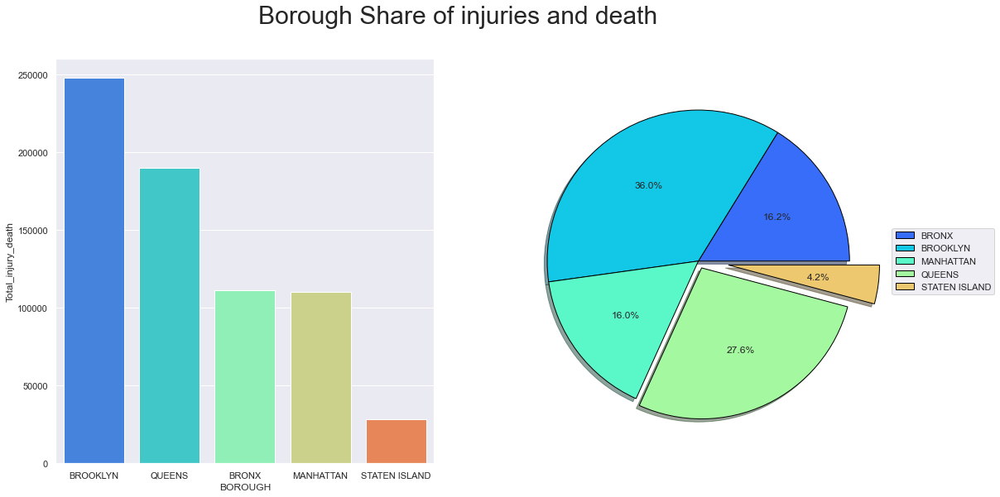

In [26]:
fig, (ax1,ax2) = plt.subplots(1,2,figsize=(18,9))
sns.barplot(x="BOROUGH", y = 'Total_injury_death', data=borough_injury,order=["BROOKLYN","QUEENS","BRONX","MANHATTAN","STATEN ISLAND"],
              ax=ax1,palette="rainbow",)

colors = sns.color_palette("rainbow")
explode=[0,0,0,0.05,0.2]
ax2.pie(borough_injury["Total_injury_death"],autopct="%1.1f%%",
       wedgeprops={"edgecolor":"black"},shadow=True,explode=explode,colors=colors)

plt.legend(bbox_to_anchor=(1,0.6),labels=["BRONX","BROOKLYN","MANHATTAN","QUEENS","STATEN ISLAND"])
fig.suptitle("Borough Share of injuries and death",fontsize=30)

### Number of injuries and death change by time

Text(0, 0.5, 'Number of injuries and death by hour')

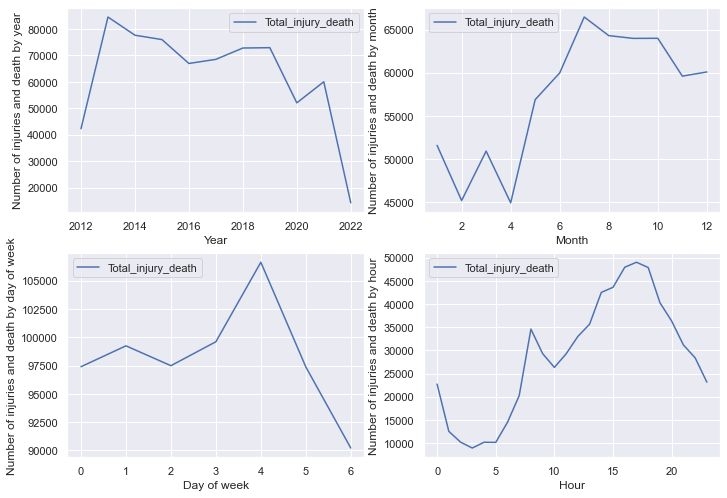

In [27]:
injury_year = pd.DataFrame(df.groupby('Year')['Total_injury_death'].sum())
injury_month = pd.DataFrame(df.groupby('Month')['Total_injury_death'].sum())
injury_dow = pd.DataFrame(df.groupby('Day_of_week')['Total_injury_death'].sum())
injury_h = pd.DataFrame(df.groupby('Hour')['Total_injury_death'].sum())


sns.set(rc={'figure.figsize':(11.7,8.27)})

#define plotting region (2 rows, 2 columns)
fig, axes = plt.subplots(2, 2)


plot_y_injury = sns.lineplot(data=injury_year, ax=axes[0,0])
plot_y_injury.set_xlabel("Year")
plot_y_injury.set_ylabel("Number of injuries and death by year")

plot_month_injury = sns.lineplot(data=injury_month, ax=axes[0,1])
plot_month_injury.set_xlabel("Month")
plot_month_injury.set_ylabel("Number of injuries and death by month")

plot_dow_injury = sns.lineplot(data=injury_dow, ax=axes[1,0])
plot_dow_injury.set_xlabel("Day of week")
plot_dow_injury.set_ylabel("Number of injuries and death by day of week")

plot_hour_injury = sns.lineplot(data=injury_h, ax=axes[1,1])
plot_hour_injury.set_xlabel("Hour")
plot_hour_injury.set_ylabel("Number of injuries and death by hour")

Text(0, 0.5, 'Number of injuries and death by hour')

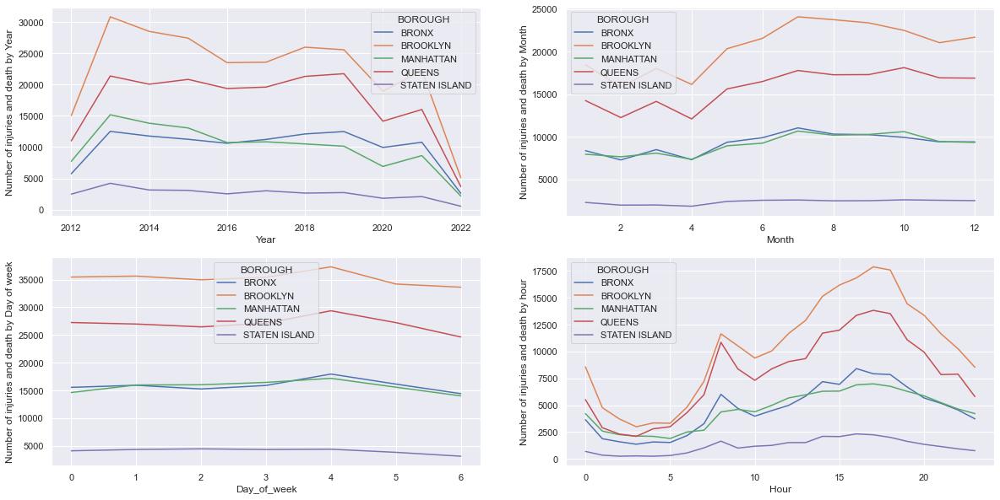

In [28]:
borough_year_injury = pd.DataFrame(df.groupby(['Year', 'BOROUGH']).Number_of_injuries.sum())
borough_year_injury.reset_index(inplace = True)

borough_month_injury = pd.DataFrame(df.groupby(['Month', 'BOROUGH']).Number_of_injuries.sum())
borough_month_injury.reset_index(inplace = True)

borough_dow_injury = pd.DataFrame(df.groupby(['Day_of_week', 'BOROUGH']).Number_of_injuries.sum())
borough_dow_injury.reset_index(inplace = True)

borough_hour_injury = pd.DataFrame(df.groupby(['Hour', 'BOROUGH']).Number_of_injuries.sum())
borough_hour_injury.reset_index(inplace = True)

sns.set(rc={'figure.figsize':(20,10)})

#define plotting region (2 rows, 2 columns)
fig, axes = plt.subplots(2, 2)

#create lineplot in each subplot
plot_year = sns.lineplot(x = 'Year', y = 'Number_of_injuries', hue = 'BOROUGH', data = borough_year_injury, ax=axes[0,0])
plot_year.set_xlabel("Year")
plot_year.set_ylabel("Number of injuries and death by Year")

plot_month = sns.lineplot(x = 'Month', y = 'Number_of_injuries', hue = 'BOROUGH', data = borough_month_injury, ax=axes[0,1])
plot_month.set_xlabel("Month")
plot_month.set_ylabel("Number of injuries and death by Month")

plot_dw = sns.lineplot(x = 'Day_of_week', y = 'Number_of_injuries', hue = 'BOROUGH', data = borough_dow_injury, ax=axes[1,0])
plot_dw.set_xlabel("Day_of_week")
plot_dw.set_ylabel("Number of injuries and death by Day of week")

plot_hour = sns.lineplot(x = 'Hour', y = 'Number_of_injuries', hue = 'BOROUGH', data = borough_hour_injury, ax=axes[1,1])
plot_hour.set_xlabel("Hour")
plot_hour.set_ylabel("Number of injuries and death by hour")




### Injuries and death yearly change by borough

In [29]:
year_injury_death = pd.DataFrame(df.groupby(["BOROUGH", "Year"])["Total_injury_death"].sum())
year_injury_death_new = year_injury_death.unstack().T
year_injury_death_new.reset_index(inplace=True)
year_injury_death_new.set_index('Year', inplace=True)
year_injury_death_new.drop('level_0', axis = 1, inplace=True)
year_injury_death_new = year_injury_death_new.T
year_injury_death_new.columns = year_injury_death_new.columns.astype('str')
year_injury_death_new['2023'] = year_injury_death_new['2012']



In [30]:
from bokeh.layouts import column, row
from bokeh.models import CustomJS, Slider
from bokeh.plotting import ColumnDataSource, figure, show, output_notebook

source = ColumnDataSource(year_injury_death_new)

tooltips = [
    ('Total number of injuries and death', '@2023')
]

p = figure(x_range=source.data['BOROUGH'], plot_height=400, 
           x_axis_label = "Borough",
           y_axis_label = "Number of injuries and death",
           title="Number of injuries and death by year",
           tooltips=tooltips)

p.vbar(x = 'BOROUGH', 
       top = '2023', 
       source = source,
       width = 0.5, 
       color = "cyan")

p.xgrid.grid_line_color = None
p.y_range.start = 0    

#FILL THIS IN (https://docs.bokeh.org/en/latest/docs/gallery/slider.html)
slider = Slider(start = 2012, end = 2022, value = 0, step = 1, title="Year")

jscallback = CustomJS(args = {'source':source, 'slider':slider}, code="""
        // widget. this.item is the selected value
        // We can print it on the JavaScript console
        // Chrome windows/linux: Ctrl - Shift - J
        // Chrom mac: Cmd - Option - J
        // Safari: Option - Cmd - C
        
        console.log(' changed selected option', slider.value);

        //data is the variable containing all the data
        var data = source.data;
        var col = this.value
        console.log(' changed selected option', data[col]);
        
        // allocate the selected column to the field for the y values
        data['2023'] = data[col];

        // register the change 
        source.change.emit();
""")

slider.js_on_change("value", jscallback)

layout = row(p,slider)
show(layout)

### Injuries and death monthly change by borough

In [31]:
month_injury_death = pd.DataFrame(df.groupby(["BOROUGH", "Month"])["Total_injury_death"].sum())
month_injury_death_new = month_injury_death.unstack().T
month_injury_death_new.reset_index(inplace=True)
month_injury_death_new.set_index('Month', inplace=True)
month_injury_death_new.drop('level_0', axis = 1, inplace=True)
month_injury_death_new = month_injury_death_new.T
month_injury_death_new.columns = month_injury_death_new.columns.astype('str')
month_injury_death_new['13'] = month_injury_death_new['1']



In [32]:
from bokeh.layouts import column, row
from bokeh.models import CustomJS, Slider
from bokeh.plotting import ColumnDataSource, figure, show, output_notebook

source = ColumnDataSource(month_injury_death_new)

tooltips = [
    ('Total number of injuries and death', '@13')
]

p = figure(x_range=source.data['BOROUGH'], plot_height=400, 
           x_axis_label = "Borough",
           y_axis_label = "Number of injuries and death",
           title="Number of injuries and death by month",
           tooltips=tooltips)

p.vbar(x = 'BOROUGH', 
       top = '13', 
       source = source,
       width = 0.5, 
       color = "cyan")

p.xgrid.grid_line_color = None
p.y_range.start = 0    

#FILL THIS IN (https://docs.bokeh.org/en/latest/docs/gallery/slider.html)
slider = Slider(start = 1, end = 12, value = 0, step = 1, title="Month")

jscallback = CustomJS(args = {'source':source, 'slider':slider}, code="""
        // widget. this.item is the selected value
        // We can print it on the JavaScript console
        // Chrome windows/linux: Ctrl - Shift - J
        // Chrom mac: Cmd - Option - J
        // Safari: Option - Cmd - C
        
        console.log(' changed selected option', slider.value);

        //data is the variable containing all the data
        var data = source.data;
        var col = this.value
        console.log(' changed selected option', data[col]);
        
        // allocate the selected column to the field for the y values
        data['13'] = data[col];

        // register the change 
        source.change.emit();
""")

slider.js_on_change("value", jscallback)

layout = row(p,slider)
show(layout)


### Injuries and death weekly change by borough

In [33]:
dow_injury_death = pd.DataFrame(df.groupby(["BOROUGH", "Day_of_week"])["Total_injury_death"].sum())
dow_injury_death_new = dow_injury_death.unstack().T
dow_injury_death_new.reset_index(inplace=True)
dow_injury_death_new.set_index('Day_of_week', inplace=True)
dow_injury_death_new.drop('level_0', axis = 1, inplace=True)
dow_injury_death_new = dow_injury_death_new.T
dow_injury_death_new.columns = dow_injury_death_new.columns.astype('str')
dow_injury_death_new['7'] = dow_injury_death_new['0']




In [34]:
from bokeh.layouts import column, row
from bokeh.models import CustomJS, Slider
from bokeh.plotting import ColumnDataSource, figure, show, output_notebook

source = ColumnDataSource(dow_injury_death_new)

tooltips = [
    ('Total number of injuries and death', '@7')
]

p = figure(x_range=source.data['BOROUGH'], plot_height=400, 
           x_axis_label = "Borough",
           y_axis_label = "Number of injuries and death",
           title="Number of injuries and death by day of week",
           tooltips=tooltips)

p.vbar(x = 'BOROUGH', 
       top = '7', 
       source = source,
       width = 0.5, 
       color = "cyan")

p.xgrid.grid_line_color = None
p.y_range.start = 0    

#FILL THIS IN (https://docs.bokeh.org/en/latest/docs/gallery/slider.html)
slider = Slider(start = 0, end = 6, value = 0, step = 1, title="Day_of_week")

jscallback = CustomJS(args = {'source':source, 'slider':slider}, code="""
        // widget. this.item is the selected value
        // We can print it on the JavaScript console
        // Chrome windows/linux: Ctrl - Shift - J
        // Chrom mac: Cmd - Option - J
        // Safari: Option - Cmd - C
        
        console.log(' changed selected option', slider.value);

        //data is the variable containing all the data
        var data = source.data;
        var col = this.value
        console.log(' changed selected option', data[col]);
        
        // allocate the selected column to the field for the y values
        data['7'] = data[col];

        // register the change 
        source.change.emit();
""")

slider.js_on_change("value", jscallback)

layout = row(p,slider)
show(layout)


### Injuries and death hourly change by borough

In [35]:
hour_injury_death = pd.DataFrame(df.groupby(["BOROUGH", "Hour"])["Total_injury_death"].sum())
hour_injury_death_new = hour_injury_death.unstack().T
hour_injury_death_new.reset_index(inplace=True)
hour_injury_death_new.set_index('Hour', inplace=True)
hour_injury_death_new.drop('level_0', axis = 1, inplace=True)
hour_injury_death_new = hour_injury_death_new.T
hour_injury_death_new.columns = hour_injury_death_new.columns.astype('str')
hour_injury_death_new['24'] = hour_injury_death_new['0']





In [36]:
from bokeh.layouts import column, row
from bokeh.models import CustomJS, Slider
from bokeh.plotting import ColumnDataSource, figure, show, output_notebook

source = ColumnDataSource(hour_injury_death_new)

tooltips = [
    ('Total number of injuries and death', '@24')
]

p = figure(x_range=source.data['BOROUGH'], plot_height=400, 
           x_axis_label = "Borough",
           y_axis_label = "Number of injuries and death",
           title="Number of injuries and death by hour",
           tooltips=tooltips)

p.vbar(x = 'BOROUGH', 
       top = '24', 
       source = source,
       width = 0.5, 
       color = "cyan")

p.xgrid.grid_line_color = None
p.y_range.start = 0    

#FILL THIS IN (https://docs.bokeh.org/en/latest/docs/gallery/slider.html)
slider = Slider(start = 0, end = 23, value = 0, step = 1, title="Hour")

jscallback = CustomJS(args = {'source':source, 'slider':slider}, code="""
        // widget. this.item is the selected value
        // We can print it on the JavaScript console
        // Chrome windows/linux: Ctrl - Shift - J
        // Chrom mac: Cmd - Option - J
        // Safari: Option - Cmd - C
        
        console.log(' changed selected option', slider.value);

        //data is the variable containing all the data
        var data = source.data;
        var col = this.value
        console.log(' changed selected option', data[col]);
        
        // allocate the selected column to the field for the y values
        data['24'] = data[col];

        // register the change 
        source.change.emit();
""")

slider.js_on_change("value", jscallback)

layout = row(p,slider)
show(layout)


### Summary
- Brooklyn has the most number of collisions as well as injuries and death, followed by Queens. 
- As for time change, collisions in New York City decrease drastically after 2020, and increase a lot from June to July and remain high during the second half year. Friday has the most collisions among one week (4 - Friday). There are two collision peaks during one day, one peak is around 9 am, the other is around 5 pm. 
- The number of injuries and death is also consistent with the patterns of collisions.

## 2. Factors Analysis

### Top 10 Factors leading to collisions

In [37]:
factor = df.groupby('CONTRIBUTING FACTOR VEHICLE 1', as_index=False).size().sort_values(by = 'size', ascending = False)
factor_top10 = factor[0:10]



Text(0.5, 0, 'Contributing Factor')

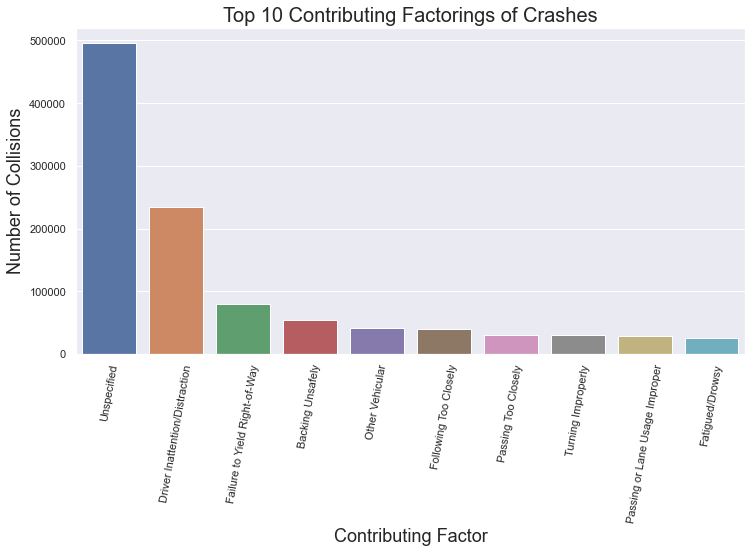

In [38]:
plt.figure(figsize=(12,6))
plot_factor = sns.barplot(x='CONTRIBUTING FACTOR VEHICLE 1', y='size', data=factor_top10)
plt.xticks(rotation = 80)
plot_factor.set_title("Top 10 Contributing Factorings of Crashes",fontsize=20)
plot_factor.set_ylabel('Number of Collisions',size=18)
plot_factor.set_xlabel('Contributing Factor',size=18)

### Top 10 most common vehicle types

In [39]:
vehicle = df.groupby('VEHICLE TYPE CODE 1', as_index=False).size().sort_values(by = 'size', ascending = False)
vehicle_top10 = vehicle[0:10]



Text(0.5, 0, 'Contributing Factor')

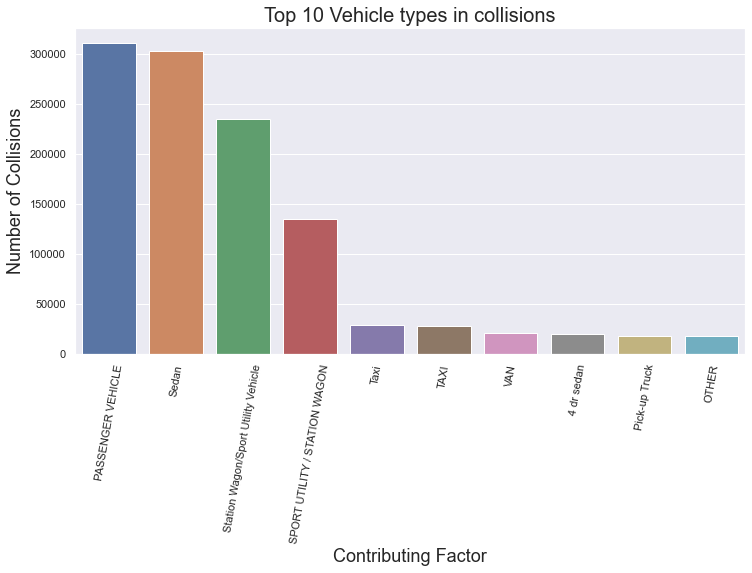

In [40]:
plt.figure(figsize=(12,6))
plot_factor = sns.barplot(x='VEHICLE TYPE CODE 1', y='size', data=vehicle_top10)
plt.xticks(rotation = 80)
plot_factor.set_title("Top 10 Vehicle types in collisions",fontsize=20)
plot_factor.set_ylabel('Number of Collisions',size=18)
plot_factor.set_xlabel('Contributing Factor',size=18)

In [41]:
street = df.groupby('ON STREET NAME', as_index=False).size().sort_values(by = 'size', ascending = False)
street10 = street[0:10]



Text(0.5, 0, 'Most common street')

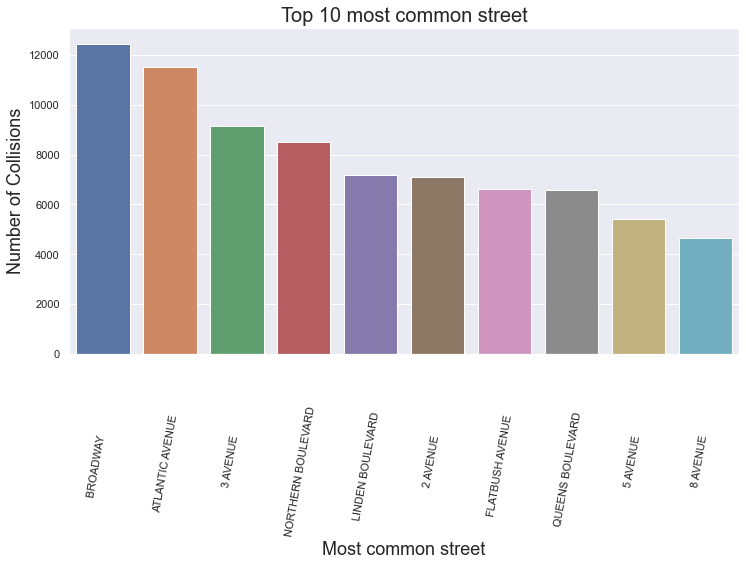

In [42]:
plt.figure(figsize=(12,6))
plot_factor = sns.barplot(x='ON STREET NAME', y='size', data=street10)
plt.xticks(rotation = 80)
plot_factor.set_title("Top 10 most common street",fontsize=20)
plot_factor.set_ylabel('Number of Collisions',size=18)
plot_factor.set_xlabel('Most common street',size=18)

![Broadway](Broadway.png)

![Atlantic_avenue](Atlantic_street.png)

### Summary
- Though there are many unspecified reasons, we can conclude that most collisions are due to drivers’ wrong behavior, e.g. inattention, turned the wrong way, following too closely, etc. 
- As for the leading vehicles, most collisions occur among small vehicles like sedan, etc. 
- Broadway and Atlantic Avenue are the top 2 streets where most collisions happen. That might help explain why there are so many collisions in Brooklyn and Queens.

## 3. Risk Prediction

We also tried to build Machine Learning models on predicting whether one area is high risk or low risk. We classify areas with 6 more injuries and deaths as high-risk areas and fewer low-risk areas. The dependent variable is risk level. The independent variables include boroughs, zip codes, months, days, etc. We tried three different models: random forest, Naive SGD model, and Balanced SGD model.

### Machine Learning: predicting the high risk collision area

Text(0.5, 1.0, 'NYC Crash Density By Borough')

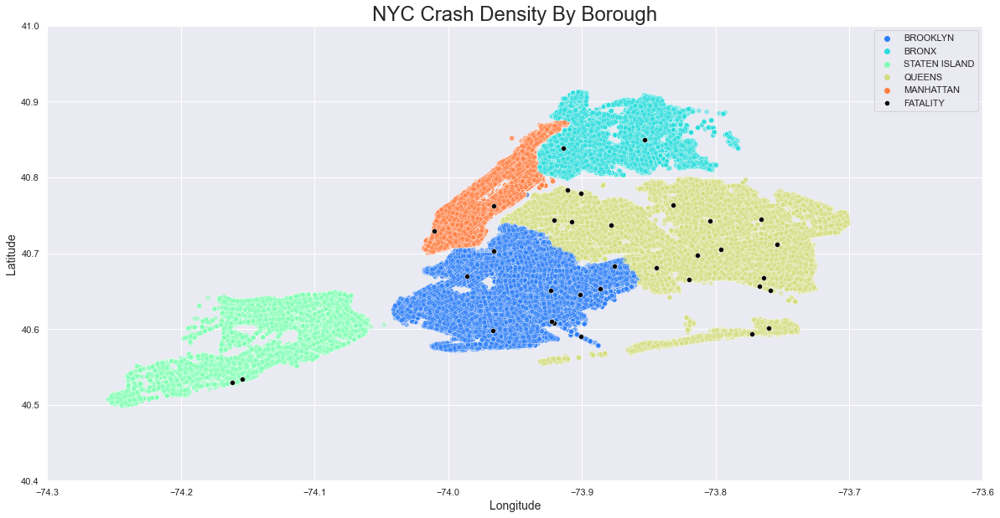

In [43]:
sns.scatterplot(x="LONGITUDE",y="LATITUDE",data=df,hue="BOROUGH",palette="rainbow",
               alpha=0.5)
plt.ylim(40.4,41)
plt.xlim(-74.3,-73.6)
plt.ylabel("Latitude",fontsize=14)
plt.xlabel("Longitude",fontsize=14)

sns.scatterplot(x="LONGITUDE",y="LATITUDE",data=df[df["Number_of_death"]>2],color="black",label="FATALITY")
plt.title("NYC Crash Density By Borough",fontsize=24)

In [44]:
new_collision_data = df[['Year', 'Month', 'Day', 'Day_of_week', 'Hour', 'datetime',
                                    'BOROUGH', 'ZIP CODE', 'LATITUDE', 'LONGITUDE', 'Number_of_injuries',
                                    'Number_of_death', 'Total_injury_death', 'CONTRIBUTING FACTOR VEHICLE 1','VEHICLE TYPE CODE 1']]

new_collision_data.dropna(subset = ['Year', 'Month', 'Day', 'Day_of_week', 'Hour', 'datetime',
                                    'BOROUGH', 'ZIP CODE', 'LATITUDE', 'LONGITUDE', 'Number_of_injuries',
                                    'Number_of_death', 'Total_injury_death', 'CONTRIBUTING FACTOR VEHICLE 1','VEHICLE TYPE CODE 1'], inplace = True)

new_collision_data.drop(['Year', 'datetime', 'Number_of_injuries', 'Number_of_death'], axis = 1, inplace = True)
new_collision_data.reset_index(drop = True, inplace = True)






In [45]:
#'BROOKLYN' : '0', 'BRONX' : '1', 'STATEN ISLAND' : '2', 'QUEENS' : '3', 'MANHATTAN': '4'
borough_map = {'BROOKLYN' : '0', 'BRONX' : '1', 'STATEN ISLAND' : '2', 'QUEENS' : '3', 'MANHATTAN': '4'}

#0: unknown factor 1:driver's factor 2:vehicle's factor 3:environment
factor_map = {
    'Unspecified' : '0', 
    'Passing or Lane Usage Improper' : '1',
    'Driver Inexperience' : '1', 
    'Failure to Yield Right-of-Way' : '1',
    'Following Too Closely' : '1', 
    'Turning Improperly' : '1', 
    'Unsafe Speed' : '1',
    'Backing Unsafely' : '1', 
    'Driver Inattention/Distraction' : '1',
    'Passing Too Closely' : '1', 
    'Steering Failure' : '1',
    'Traffic Control Disregarded' : '1', 
    'Drugs (illegal)' : '1',
    'Reaction to Uninvolved Vehicle' : '1', 
    'View Obstructed/Limited': '1',
    'Pedestrian/Bicyclist/Other Pedestrian Error/Confusion': '3',
    'Alcohol Involvement': '1', 
    'Pavement Slippery': '2', 
    'Brakes Defective': '2',
    'Oversized Vehicle': '2', 
    'Animals Action': '3', 
    'Unsafe Lane Changing': '1',
    'Outside Car Distraction': '3', 
    'Illnes': '1', 
    'Other Vehicular': '3',
    'Aggressive Driving/Road Rage': '1', 
    'Fell Asleep': '1',
    'Tire Failure/Inadequate': '2', 
    'Pavement Defective': '2',
    'Lost Consciousness': '1', 
    'Accelerator Defective': '2',
    'Passenger Distraction': '3', 
    'Glare': '1', 
    'Eating or Drinking': '1',
    'Cell Phone (hands-free)': '1', 
    'Lane Marking Improper/Inadequate': '2',
    'Failure to Keep Right': '1', 
    'Obstruction/Debris': '3', 
    'Fatigued/Drowsy': '1',
    'Physical Disability': '1', 
    'Cell Phone (hand-Held)': '1',
    'Headlights Defective': '2', 
    'Tinted Windows': '2', 
    'Vehicle Vandalism': '2',
    'Driverless/Runaway Vehicle': '2', 
    'Prescription Medication': '1', 
    'Texting': '1',
    'Traffic Control Device Improper/Non-Working': '2',
    'Using On Board Navigation Device': '1', 
    'Tow Hitch Defective': '2',
    'Shoulders Defective/Improper': '1', 
    'Windshield Inadequate': '2',
    'Other Lighting Defects': '2', 
    'Other Electronic Device': '2',
    'Listening/Using Headphones': '1',
    'Reaction to Other Uninvolved Vehicle': '1', 
    '80': '0', 
    '1': '0',
    'Drugs (Illegal)': '1', 
    'Illness' : '1', 
    'Cell Phone (hand-held)': '1'
}

#vehicle's type 0:unkown, 1:small vehicle, 2:medium vehicle, 3:large vehicle
vehicle_map = {
    'Sedan': '2', 
    '�MBU': '1', 
    'Station Wagon/Sport Utility Vehicle': '3', 
    '...': '0',
    'TAXI':'2', 
    'scoo': '1', 
    'PEDICAB': '1'
}



In [46]:
new_collision_data['BOROUGH'] = new_collision_data['BOROUGH'].map(borough_map)
new_collision_data['CONTRIBUTING FACTOR VEHICLE 1'] = new_collision_data['CONTRIBUTING FACTOR VEHICLE 1'].map(factor_map)
new_collision_data['VEHICLE TYPE CODE 1'] = new_collision_data['VEHICLE TYPE CODE 1'].map(vehicle_map)
new_collision_data['VEHICLE TYPE CODE 1'].fillna('0', inplace = True)



In [47]:
#0: low risk 1: high risk
def risk_classification(i):
    if i <= 6:
        return 0
    else:
        return 1

new_collision_data['Total_injury_death'] = new_collision_data.Total_injury_death.apply(risk_classification)

In [48]:
new_collision_data.rename(columns = {
    'BOROUGH':'Borough',
    'ZIP CODE':'Zipcode',
    'LATITUDE':'Latitude',
    'LONGITUDE':'Longitude',
    'Total_injury_death':'Risk_level',
    'CONTRIBUTING FACTOR VEHICLE 1':'Factors',
    'VEHICLE TYPE CODE 1':'Vehicle_type'
}, inplace = True)

In [49]:
y = new_collision_data['Risk_level']
x = new_collision_data.iloc[:,new_collision_data.columns != 'Risk_level']

In [50]:
from sklearn.model_selection import train_test_split
from imblearn.under_sampling import RandomUnderSampler

rus = RandomUnderSampler(random_state=0)
X_resampled, y_resampled = rus.fit_resample(x, y)

X_train, X_test, y_train, y_test = train_test_split(X_resampled, y_resampled, random_state = 23456) 



In [51]:
#StandardScaler
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler().fit(X_train)
X_train_scaled = scaler.transform(X_train)
X_test_scaled = scaler.transform(X_test)

In [52]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import confusion_matrix
from sklearn.metrics import f1_score,recall_score,precision_score
import warnings
warnings.filterwarnings('ignore')

tree_class = DecisionTreeClassifier(random_state=0)
tree_class.fit(X_train_scaled, y_train)

test_pred_model = tree_class.predict(X_test_scaled) 
cfm_model = confusion_matrix(y_test, test_pred_model) 
train_acc_model = tree_class.score(X_train_scaled,y_train)
test_acc_model = tree_class.score(X_test_scaled,y_test)
print("Training accuracy: ",train_acc_model)
print("Testing  accuracy: ",test_acc_model)
print("confusion matrix:",cfm_model,sep="\n")

f1_model = f1_score(y_test, test_pred_model)
precision_model = recall_score(y_test, test_pred_model)
recall_model = precision_score(y_test, test_pred_model)

print("precision: ",precision_model)
print("recall: ",recall_model)
print("f1 score: ",f1_model)



Training accuracy:  1.0
Testing  accuracy:  0.5514663599769982
confusion matrix:
[[991 783]
 [777 927]]
precision:  0.5440140845070423
recall:  0.5421052631578948
f1 score:  0.5430579964850616


In [53]:
from sklearn.linear_model import SGDClassifier
from sklearn.metrics import confusion_matrix
from sklearn.metrics import f1_score,recall_score,precision_score
import warnings
warnings.filterwarnings('ignore')

model_1 = SGDClassifier(random_state=42, max_iter=1000)  #Create the SGD Classifier (use random state 42 and max_iter 1000)
model_1.fit(X_train_scaled, y_train)

test_pred_model_1 = model_1.predict(X_test_scaled) #model_1 test data predictions go here
cfm_model_1 = confusion_matrix(y_test, test_pred_model_1) #model_1 confusion matrix on test data goes here
train_acc_model_1 = model_1.score(X_train_scaled,y_train)
test_acc_model_1 = model_1.score(X_test_scaled,y_test)
print("Training accuracy: ",train_acc_model_1)
print("Testing  accuracy: ",test_acc_model_1)
print("confusion matrix:",cfm_model_1,sep="\n")

f1_model_1 = f1_score(y_test, test_pred_model_1)#model_1 f1 score on test data goes here
precision_model_1 = recall_score(y_test, test_pred_model_1)#model_1 precision score on test data goes here
recall_model_1 = precision_score(y_test, test_pred_model_1)#model_1 recall score on test data goes here

print("precision: ",precision_model_1)
print("recall: ",recall_model_1)
print("f1 score: ",f1_model_1)



Training accuracy:  0.5783017059612804
Testing  accuracy:  0.5517538815411156
confusion matrix:
[[ 723 1051]
 [ 508 1196]]
precision:  0.7018779342723005
recall:  0.5322652425456164
f1 score:  0.6054163502910657


In [54]:
model_2 = SGDClassifier(random_state=42,max_iter=1000,class_weight={1:9}) #Increase positives by a factor of 9
model_2.fit(X_train_scaled, y_train)
test_pred_model_2 = model_2.predict(X_test_scaled)#model_2 predictions on test data go here
cfm_model_2 = confusion_matrix(y_test, test_pred_model_2)#model_2 confusion matrix on test data goes here
train_acc_model_2 = model_2.score(X_train_scaled,y_train)
test_acc_model_2 = model_2.score(X_test_scaled,y_test)
print("Training accuracy: ",train_acc_model_2)
print("Testing  accuracy: ",test_acc_model_2)
print("confusion matrix:",cfm_model_2,sep="\n")

from sklearn.metrics import f1_score,recall_score,precision_score
f1_model_2 = f1_score(y_test, test_pred_model_2)#model_2 test f1score goes here
precision_model_2 = recall_score(y_test, test_pred_model_2)#model_2 test precision goes here
recall_model_2 = precision_score(y_test, test_pred_model_2)#model_2 test recall goes here

print("precision: ",precision_model_2)
print("recall: ",recall_model_2)
print("f1 score: ",f1_model_2)

Training accuracy:  0.5011500862564693
Testing  accuracy:  0.4861989649223692
confusion matrix:
[[   8 1766]
 [  21 1683]]
precision:  0.9876760563380281
recall:  0.48796752681936795
f1 score:  0.6532117213273821


The below table shows the metrics and accuracy of the three models. As can be seen from the table, all the three models have pros and cons, however, their accuracy is not high, around 50%, which means they are all random models, and can not be used to predict whether one spot is high or not.

![Atlantic_avenue](model_compare.png)

The three charts show the AUC curve for the three models. The largest AUC is around 0.54, which means the three models are all random models.

In [55]:
from bokeh.io import output_notebook, show 
from bokeh.plotting import figure
from bokeh.layouts import gridplot
output_notebook()

Loading BokehJS ...

In [56]:
#Draw a single ROC curve for one model
#Include the AUC
#Include the random chance line
#Include gridlines to see values

def draw_one_roc_curve(fpr,tpr,thresholds,auc,model):
    #Set up the ColumnDataSource object
    from bokeh.models import LabelSet, ColumnDataSource,HoverTool
    import pandas as pd
    df_d = pd.DataFrame([fpr,tpr,thresholds]).transpose()
    df_d.columns = ["fpr","tpr","threshold"]
    source = ColumnDataSource(df_d)    
    
    
    # Create custom HoverTool -- we'll make one for each curve
    hover_ROC = HoverTool(names=['ROC'], tooltips=[("TPR", "@tpr"), 
                                                   ("FPR", "@fpr"), 
                                                   ("Thresh", "@threshold"),
                                                  ])

    # Create the tools
    p_tools_ROC = [hover_ROC, 'crosshair', 'zoom_in', 'zoom_out', 'save', 'reset', 'tap', 'box_zoom']

    p1 = figure(title="ROC Curve for "+model, tools=p_tools_ROC,x_range=(0,1),y_range=(0,1))

    p1.xaxis.axis_label = 'False Positive Rate' 
    p1.yaxis.axis_label = 'True Positive Rate'

    # plot curve and datapts
    p1.line('fpr', 'tpr', line_width=1, color="blue", source=source)
    p1.circle('fpr', 'tpr', size=3, color="orange", legend_label='auc='+auc, source=source, name='ROC')

    # Plot chance (tpr = fpr 45 degrees line)
    p1.line([0, 1], [0, 1], line_dash='dashed', line_width=0.5, color='black', name='Chance')

    # Keep the legend at the bottom 
    p1.legend.location = "bottom_right"
    
    #Return the figure
    return p1
    
    
def draw_roc_curves():
  
    #Get the predicted probabilities for each model
    #Note that we can't just use predictions because they will be 0,1 values
    from sklearn.model_selection import cross_val_predict
    predic_prob_model = cross_val_predict(tree_class,X_test_scaled,y_test,cv=5)
    predic_prob_model_1 = cross_val_predict(model_1,X_test_scaled,y_test,cv=5,method="decision_function")
    predic_prob_model_2 = cross_val_predict(model_2,X_test_scaled,y_test,cv=5,method="decision_function")

    #Get the AUC for each model
    from sklearn.metrics import roc_curve, roc_auc_score
    auc_m = roc_auc_score(y_test,predic_prob_model)
    auc_m1 = roc_auc_score(y_test,predic_prob_model_2)
    auc_m2 = roc_auc_score(y_test,predic_prob_model_2)

    
    #Format auc to two decimal places
    auc_m = "%1.2f"%auc_m
    auc_m1 = "%1.2f"%auc_m1
    auc_m2 = "%1.2f"%auc_m2
  
    #Using the predicted probabilities, get the roc curves
    #fpr = false positive rate
    #tpr = true positive rate
    #thresholds = threshold choices
    #The ROC curve reports the fpr and tpr for each chosen threshold
    fpr_m,tpr_m,thresholds_m = roc_curve(y_test,predic_prob_model)
    fpr_m1,tpr_m1,thresholds_m1 = roc_curve(y_test,predic_prob_model_1)
    fpr_m2,tpr_m2,thresholds_m2 = roc_curve(y_test,predic_prob_model_2)

    #Draw the various ROC Curves
    p=draw_one_roc_curve(fpr_m,tpr_m,thresholds_m,auc_m,"Decision Tree Model")
    p1=draw_one_roc_curve(fpr_m1,tpr_m1,thresholds_m1,auc_m1,"Naive SGD Model")
    p2=draw_one_roc_curve(fpr_m2,tpr_m2,thresholds_m2,auc_m2,"Balanced SGD Model")
    

    #Set up the grid for all the curves
    grid = gridplot([[p,p1,p2]],sizing_mode="scale_both",merge_tools=True)

    #Show the curves
    show(grid)

#Call the function
draw_roc_curves()

The three charts show the PR curves for the three models. We can see from the charts that it is really hard to find a suitable threshold to balance the precision and recall score.

In [57]:
def draw_one_PR_curve(precision,recall,thresholds,f1_score ,model):
    from bokeh.models import LabelSet, ColumnDataSource, Label
    import pandas as pd

    df_d = pd.DataFrame([recall,precision,thresholds]).transpose()
    df_d.columns = ["recall","precision","threshold"]

    source = ColumnDataSource(df_d)

    p_tools = ['crosshair', 'zoom_in', 'zoom_out', 'save', 'reset', 'tap', 'box_zoom']

    #Figure
    p = figure(title="PR Curve for "+model, tools=p_tools)
    p.xaxis.axis_label = 'threshold' 
    p.yaxis.axis_label = 'precision/recall'
    
    #Add lines for precision and recall
    p.line('threshold', 'precision', line_width=1, color="blue", source=source,legend_label="precision")
    p.line('threshold', 'recall', line_width=1, color="red", source=source,legend_label="recall")
    
    f1_label = Label(x=1.0, y=.70, x_units='screen', y_units='screen', text='F1 Score='+f1_score, render_mode='css',
      border_line_color='black', border_line_alpha=0.0,
      background_fill_color='white', background_fill_alpha=1.0)
    
    p.add_layout(f1_label)
   
    # legend location
    p.legend.location = "bottom_left"
    return p

def draw_pr_curves():
    #Get the predicted probabilities for each model
    #Note that we can't just use predictions because they will be 0,1 values
    from sklearn.model_selection import cross_val_predict
    from sklearn.metrics import precision_recall_curve

    predic_prob_model = cross_val_predict(tree_class,X_test_scaled,y_test,cv=5)
    predic_prob_model_1 = cross_val_predict(model_1,X_test_scaled,y_test,cv=5,method="decision_function")
    predic_prob_model_2 = cross_val_predict(model_2,X_test_scaled,y_test,cv=5,method="decision_function")
    

    #Get precisions and recalls
    precision,recall,thresholds = precision_recall_curve(y_test,predic_prob_model)
    precision_1,recall_1,thresholds_1 = precision_recall_curve(y_test,predic_prob_model_1)
    precision_2,recall_2,thresholds_2 = precision_recall_curve(y_test,predic_prob_model_2)
    
    #draw the curves
    p = draw_one_PR_curve(precision,recall,thresholds,str("%1.2f"%f1_model),"Decision Tree Model")
    p1 = draw_one_PR_curve(precision_1,recall_1,thresholds_1,str("%1.2f"%f1_model_1),"Naive SGD Model")
    p2 = draw_one_PR_curve(precision_2,recall_2,thresholds_2,str("%1.2f"%f1_model_2),"Balanced SGD Model")
 
    #Set up the grid for all the curves
    grid = gridplot([[p,p1,p2]],sizing_mode="scale_both",merge_tools=True)

    #Show the curves
    show(grid)

draw_pr_curves()

### Summary
- The accuracy of the three models for the training sets is high, however, the accuracy of the testing sets is low, around 50%.
- The performance of the three models is not good enough to predict whether one spot is high risk or low risk.
- All the three models are nearly the random model, which means Machine Learning models do not help in predict whether one spot is low risk or high risk.

## 4. Policy suggestions & limitations

### Policy Suggestions
- Need to investigate specific road conditions in Brooklyn and Queens
    - Identify flashpoints at specific intersections 
    - Need to look at traffic flows, infrastructure design
- General policies
    - Better traffic management needed during weekday morning and evening peak hours, e.g. set more police during the peak hours at some important intersections
    - Pending further information on contributing factors, we can figure out that most contributing factors are due to human or drivers’ behavior, thus we can consider focusing education campaigns on inattention and right-of-way

### Limitations
- We just focus on very broad scope for the whole New York City area, actually some parts in different boroughs need further and deeper investigation, e.g. some areas in Brooklyn.
- We dropped some missing values in the dataset, which might have negative impacts on our analysis.
- When we tried machine learning models, the features are decided by ourselves, e.g. we set the number of injuries and death greater than 6 as high risk, this might not accurate. 